In [1]:
import birankpy
from birank_bias_regularization import *
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import scipy.sparse as spa
from networkx.algorithms import bipartite
import scipy.io
import random
from scipy import stats
%matplotlib inline

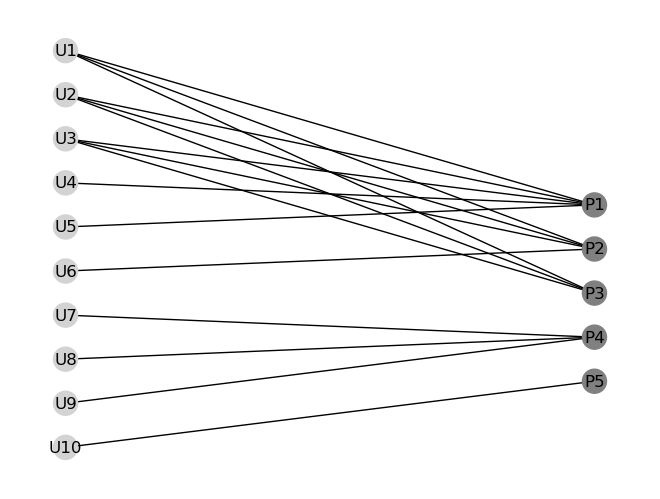

In [2]:
# Define the sets of users and products
users = ['U1', 'U2', 'U3', 'U4', 'U5', 'U6', 'U7', 'U8', 'U9', 'U10']
products = ['P1', 'P2', 'P3', 'P4', 'P5']

# Define the edges between users and products
edges = [
    ('U1', 'P1'), ('U2', 'P1'), ('U3', 'P1'), ('U4', 'P1'), ('U5', 'P1'), # Reviews for P1
    ('U1', 'P2'), ('U2', 'P2'), ('U3', 'P2'), ('U6', 'P2'),  # Reviews for P2
    ('U1', 'P3'), ('U2', 'P3'), ('U3', 'P3'),  # Reviews for P3
    ('U7', 'P4'), ('U8', 'P4'),  ('U9', 'P4'), # Reviews for P4
    ('U10', 'P5')  # Reviews for P5
]

# Create a bipartite graph
B = nx.Graph()
# Add nodes with the node attribute "bipartite"
B.add_nodes_from(users, bipartite=0)  # 0 to indicate one set of nodes
B.add_nodes_from(products, bipartite=1)  # 1 to indicate the other set
# Add edges only between nodes of opposite sets
B.add_edges_from(edges)

# Generate a layout for our nodes 
pos = {}
# Update position for user nodes (inverted index for users to place U1 at the top)
pos.update((node, (1, len(users) - index)) for index, node in enumerate(users))
# Update position for product nodes (centered vertically)
pos.update((node, (2, len(products) - 1 - index + (len(users) - len(products))/2 )) for index, node in enumerate(products))

# Draw the bipartite graph
nx.draw(B, pos, with_labels=True, node_color=['lightgrey' if node in users else 'grey' for node in B])
plt.show()

In [3]:
# Create an empty adjacency matrix
adj_matrix = spa.dok_matrix((len(users), len(products)), dtype=np.int8)

# Populate the adjacency matrix based on the edges
for edge in edges:
    u_idx = users.index(edge[0])
    p_idx = products.index(edge[1])
    adj_matrix[u_idx, p_idx] = 1  # Assuming all reviews are weighted equally

# Convert to a CSR (Compressed Sparse Row) matrix
adj_matrix_csr = adj_matrix.tocsr()

In [4]:
# Run the BiRank algorithm
# You may need to adjust the parameters like alpha, beta, max_iter based on your specific needs
user_scores, product_scores = birankpy.birank(adj_matrix_csr, normalizer='BiRank',alpha=0.85, beta=0.85, max_iter=20, tol=1e-4)

# user_scores and product_scores are numpy arrays containing the ranking scores of users and products, respectively
user_ranking = np.argsort(-user_scores)  # - for descending order
product_ranking = np.argsort(-product_scores)

# Print top ranked users and products
print("Top ranked users:", [users[i] for i in user_ranking[:5]])  # adjust the slice as needed
print("Top ranked products:", [products[i] for i in product_ranking[:5]])

Top ranked users: ['U10', 'U1', 'U2', 'U3', 'U7']
Top ranked products: ['P1', 'P4', 'P2', 'P5', 'P3']


In [5]:
# Run the BiRank algorithm with bias correction
# You may need to adjust the parameters like alpha, beta, max_iter based on your specific needs

# Calculate the degree of each user node
user_activity = {node: B.degree(node) for node in users}

# Convert user_activity dictionary values to a numpy array
user_activity_array = np.array([user_activity[node] for node in users])

# Run the BiRank algorithm with bias correction
user_scores, product_scores = birank_with_regularization(
    adj_matrix_csr, 
    normalizer='BiRank',
    gamma =0.01,
    alpha=0.85, 
    beta=0.85, 
    max_iter=20, 
    tol=1e-4
)

# user_scores and product_scores are numpy arrays containing the ranking scores of users and products, respectively
user_ranking = np.argsort(-user_scores)  # - for descending order
product_ranking = np.argsort(-product_scores)

# Print top ranked users and products
print("Top ranked users:", [users[i] for i in user_ranking[:5]])  # adjust the slice as needed
print("Top ranked products:", [products[i] for i in product_ranking[:5]])

Top ranked users: ['U10', 'U7', 'U8', 'U9', 'U6']
Top ranked products: ['P4', 'P5', 'P1', 'P2', 'P3']


In [6]:
def plot_bipartite_graph(B, title="Bipartite Graph", figsize=(72, 48), label_font_size=20, title_font_size=50):
    plt.figure(figsize=figsize)  # Set the figure size

    # Separate by nodes
    top_nodes = {n for n, d in B.nodes(data=True) if d['bipartite']==0}
    bottom_nodes = set(B) - top_nodes

    # Node sizes based on degree for each set of nodes
    top_sizes = [B.degree(n) * 100 for n in top_nodes]
    bottom_sizes = [B.degree(n) * 100 for n in bottom_nodes]

    # Create layout
    pos = nx.bipartite_layout(B, top_nodes)
    
    # Drawing nodes and edges
    nx.draw_networkx_nodes(B, pos, nodelist=top_nodes, node_size=top_sizes, node_color='skyblue')
    nx.draw_networkx_nodes(B, pos, nodelist=bottom_nodes, node_size=bottom_sizes, node_color='lightgreen')
    nx.draw_networkx_edges(B, pos, edge_color='gray', alpha=0.5)

    # Labels with increased font size
    nx.draw_networkx_labels(B, pos, font_size=label_font_size)

    # Set plot title with increased font size
    plt.title(title, fontsize=title_font_size)
    plt.axis('off')  # Turn off axis
    plt.show()

def plot_user_degree_distribution(B, users, figsize=(30, 10), bar_color='skyblue', edge_color='black', rotation=45):
    """
    Plots the degree distribution of user nodes in a bipartite graph.

    Parameters:
    B (networkx.Graph): The bipartite graph.
    users (list): List of user nodes in the graph.
    figsize (tuple): Size of the figure (width, height).
    bar_color (str): Color of the bars in the plot.
    edge_color (str): Color of the bar edges in the plot.
    rotation (int): Degree of rotation for the x-axis labels.
    """
    # Calculate degrees for user nodes
    user_degrees = [(user, B.degree(user)) for user in users]

    # Sort users by their degree in descending order
    user_degrees.sort(key=lambda x: x[1], reverse=True)

    # Check if user_degrees is empty
    if not user_degrees:
        print("No user degrees to plot.")
        return

    # Separate the users and their degrees
    sorted_users, sorted_degrees = zip(*user_degrees)

    # Plotting user degrees in descending order
    plt.figure(figsize=figsize)
    plt.bar(sorted_users, sorted_degrees, color=bar_color, edgecolor=edge_color)
    plt.xlabel('Users')
    plt.ylabel('Degree')
    plt.title('Degree Distribution of Users', fontsize = 20)
    plt.xticks(rotation=rotation)
    plt.show()

In [8]:
def calculate_disparity(user_scores, user_activity, threshold=0.04):
    # Calculate average ranks for items interacted by highly active and less active users
    # Assuming 'user_scores' and 'user_activity' are aligned and sorted in the same order
    high_activity_avg_rank = np.mean([user_scores[i] for i, activity in enumerate(user_activity) if activity > threshold])
    low_activity_avg_rank = np.mean([user_scores[i] for i, activity in enumerate(user_activity) if activity <= threshold])
    return high_activity_avg_rank, low_activity_avg_rank

def calculate_gini_coefficient(scores):
     # Gini coefficient calculation
    scores = np.sort(scores)
    n = len(scores)
    index = np.arange(1, n+1)
    return (np.sum((2 * index - n - 1) * scores)) / (n * np.sum(scores))

def rank_correlation(original_scores, regularized_scores):
     # Calculate Spearman's rank correlation
    return stats.spearmanr(original_scores, regularized_scores).correlation

def top_n_analysis(original_ranking, regularized_ranking, n=10):
    original_top_n = set(original_ranking[:n])
    regularized_top_n = set(regularized_ranking[:n])
    return original_top_n, regularized_top_n

def overlap_in_top_n(original_ranking, regularized_ranking, n=10):
    original_top_n = set(original_ranking[:n])
    regularized_top_n = set(regularized_ranking[:n])
    overlap = original_top_n.intersection(regularized_top_n)
    return len(overlap) / n

def interaction_analysis(user_activity, user_scores):
    plt.figure(figsize=(12, 8))  # Increased figure size for clarity
    plt.scatter(user_activity, user_scores, color='blue', edgecolor='black', alpha=0.7, s=50)  # Styling adjustments
    plt.xlabel('User Activity (Degree)', fontsize=14)  # Font size adjustment for x-axis label
    plt.ylabel('User Score (BiRank)', fontsize=14)  # Font size adjustment for y-axis label
    plt.title('Interaction Analysis: User Activity vs. Score', fontsize=16)  # Font size adjustment for title
    plt.grid(True)  # Added grid for readability
    plt.show()

def fairness_metric(high_activity_avg_rank, low_activity_avg_rank, gini_coefficient, weight=0.5, epsilon=1e-6):
    # Calculate the disparity ratio
    disparity_ratio = high_activity_avg_rank / (low_activity_avg_rank + epsilon)

    # Adjusting the formula to penalize deviations from the ideal Disparity Ratio and high Gini Coefficients
    fairness_metric_value = 1 / ((1 - weight) / (abs(disparity_ratio - 1) + epsilon) + weight / (gini_coefficient + epsilon))

    return fairness_metric_value

### Synthetic Random Graphs

In our analysis, we first explore the Random Graph model, which parallels the concepts of the Erdős–Rényi approach in network theory. This model is applied to a bipartite graph structure, encompassing two distinct sets – such as users and products – where connections between these sets are formed randomly. Each potential link between a user and a product is established based on a fixed probability, independent of other connections. This randomness in edge formation makes the Random Graph model particularly useful for simulating and understanding networks where interactions are unstructured and follow no predictable pattern. It's a fundamental model for studying the properties of networks in their simplest form, devoid of any preferential biases or structured connectivity patterns.

In [286]:
def generate_random_bipartite_graph(num_users, num_products, density=0.1):
    B = nx.Graph()
    users = ['U{}'.format(i) for i in range(num_users)]
    products = ['P{}'.format(i) for i in range(num_products)]
    B.add_nodes_from(users, bipartite=0)
    B.add_nodes_from(products, bipartite=1)

    for user in users:
        for product in products:
            if np.random.rand() <= density:
                B.add_edge(user, product)

    return B, users, products

# Example usage
B_random, users, products = generate_random_bipartite_graph(100, 500, density=0.1)

In [287]:
# def generate_random_bipartite_graph(num_users, num_products, density=0.1, biased_user_density=0.5):
#     B = nx.Graph()
#     users = ['U{}'.format(i) for i in range(num_users)]
#     products = ['P{}'.format(i) for i in range(num_products)]
#     B.add_nodes_from(users, bipartite=0)
#     B.add_nodes_from(products, bipartite=1)

#     # Randomly select 10 users to have a higher number of edges
#     biased_users = random.sample(users, 10)

#     for user in users:
#         for product in products:
#             # Determine the edge density based on whether the user is biased
#             current_density = biased_user_density if user in biased_users else density

#             # Add an edge with a probability of 'current_density', if it doesn't already exist
#             if np.random.rand() <= current_density and not B.has_edge(user, product):
#                 B.add_edge(user, product)

#     return B, users, products

# # Example usage
# B_random, users, products = generate_random_bipartite_graph(100, 50, density=0.05)

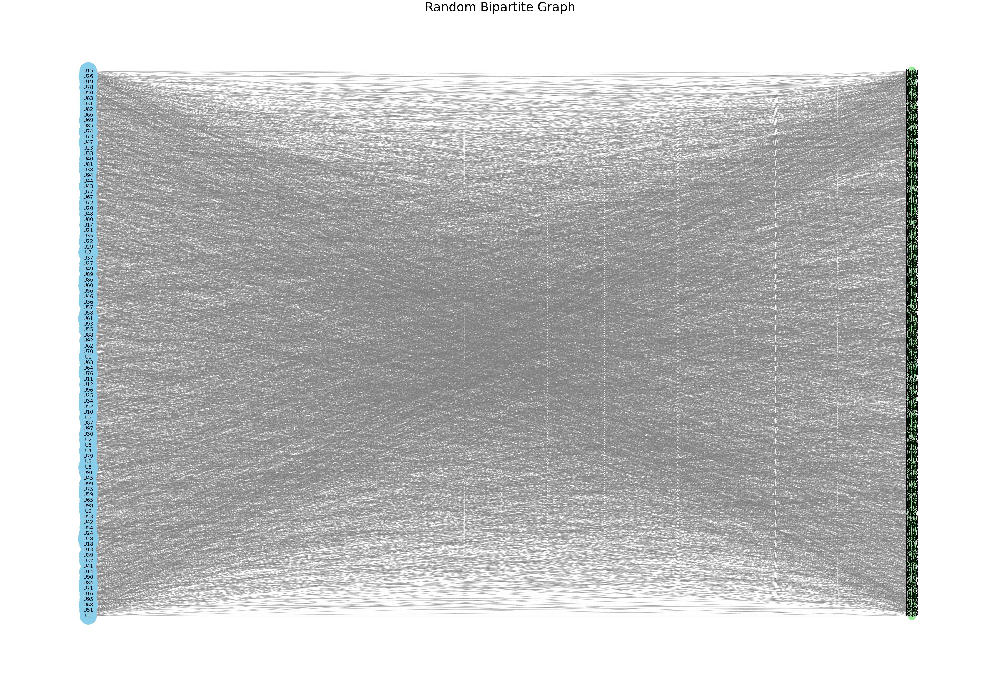

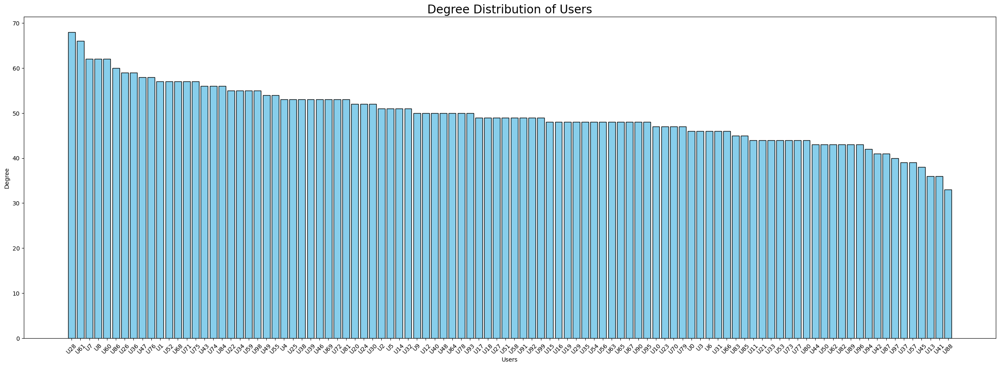

In [288]:
# Plot the random graph
plot_bipartite_graph(B_random, title="Random Bipartite Graph")

# Example usage with the B_random graph and users list
plot_user_degree_distribution(B_random, users)

#### Ranking

In [289]:
# Create an empty adjacency matrix
adj_matrix = spa.dok_matrix((len(users), len(products)), dtype=np.int8)

# Populate the adjacency matrix based on the edges in B_power_law
for u, p in B_random.edges():
    if u in users and p in products:
        u_idx = users.index(u)
        p_idx = products.index(p)
        adj_matrix[u_idx, p_idx] = 1  # Assuming all reviews are weighted equally

# Convert to a CSR (Compressed Sparse Row) matrix
adj_matrix_csr = adj_matrix.tocsr()

In [290]:
# Run the BiRank algorithm
# You may need to adjust the parameters like alpha, beta, max_iter based on your specific needs
user_scores, product_scores = birankpy.birank(adj_matrix_csr, normalizer='BiRank',alpha=0.85, beta=0.85, max_iter=100, tol=1e-4)

# user_scores and product_scores are numpy arrays containing the ranking scores of users and products, respectively
user_ranking = np.argsort(-user_scores)  # - for descending order
product_ranking = np.argsort(-product_scores)

# Print top ranked users and products
print("Top ranked users:", [users[i] for i in user_ranking[:10]])  # adjust the slice as needed
print("Top ranked products:", [products[i] for i in product_ranking[:10]])

Top ranked users: ['U28', 'U61', 'U7', 'U8', 'U60', 'U86', 'U36', 'U26', 'U47', 'U76']
Top ranked products: ['P449', 'P298', 'P98', 'P424', 'P433', 'P464', 'P257', 'P210', 'P275', 'P203']


In [291]:
# Run the BiRank algorithm with bias correction
# You may need to adjust the parameters like alpha, beta, max_iter based on your specific needs

# Run the BiRank algorithm with bias correction
user_scores_reg, product_scores_reg = birank_with_regularization(
    adj_matrix_csr,
    normalizer='BiRank',
    gamma =0.00000000001,
    alpha=0.85,
    beta=0.85,
    max_iter=1000,
    tol=1e-4
)

# user_scores and product_scores are numpy arrays containing the ranking scores of users and products, respectively
user_ranking_reg = np.argsort(-user_scores_reg)  # - for descending order
product_ranking_reg = np.argsort(-product_scores_reg)

# Print top ranked users and products
print("Top ranked users:", [users[i] for i in user_ranking_reg[:10]])  # adjust the slice as needed
print("Top ranked products:", [products[i] for i in product_ranking_reg[:10]])

Top ranked users: ['U88', 'U41', 'U13', 'U45', 'U37', 'U97', 'U57', 'U42', 'U87', 'U94']
Top ranked products: ['P360', 'P298', 'P449', 'P433', 'P257', 'P464', 'P320', 'P250', 'P98', 'P0']


In [301]:
# Disparity
# Calculate the degree of each user node
# Calculate the total degree of the network (sum of degrees of all user nodes)
total_degree = sum(B_random.degree(node) for node in users)

# Compute relative user activity for each user
relative_user_activity = {node: B_random.degree(node) / total_degree for node in users}

# Convert relative_user_activity dictionary values to a numpy array
relative_user_activity_array = np.array([relative_user_activity[node] for node in users])

high_activity_avg_rank, low_activity_avg_rank = calculate_disparity(user_scores, relative_user_activity_array, 0.01)
gini_coefficient_birank = calculate_gini_coefficient(product_scores)

metric_score_birank = fairness_metric(high_activity_avg_rank, low_activity_avg_rank, gini_coefficient_birank)

In [302]:
print("High activity average rank of Birank:", high_activity_avg_rank)
print("Low activity average rank of Birank:", low_activity_avg_rank)
print("Gini Coefficient of Birank:", gini_coefficient_birank)
print("Fairness metric of Birank:", metric_score_birank)

High activity average rank of Birank: 0.007731275532245357
Low activity average rank of Birank: 0.007141738235752654
Gini Coefficient of Birank: 0.0821556802422486
Fairness metric of Birank: 0.3054428262943233


In [303]:
high_activity_avg_rank_reg, low_activity_avg_rank_reg = calculate_disparity(user_scores_reg, relative_user_activity_array, 0.01)
gini_coefficient_reg = calculate_gini_coefficient(product_scores_reg)

metric_score_reg = fairness_metric(high_activity_avg_rank_reg, low_activity_avg_rank_reg, gini_coefficient_reg)

In [304]:
print("High activity average rank of Birank with reg:", high_activity_avg_rank_reg)
print("Low activity average rank of Birank with reg:", low_activity_avg_rank_reg)
print("Gini Coefficient of Birank with reg:", gini_coefficient_reg)
print("Fairness metric of Birank with reg:", metric_score_reg)

High activity average rank of Birank with reg: 0.00931059772577621
Low activity average rank of Birank with reg: 0.010587268603968412
Gini Coefficient of Birank with reg: 6.186009215980449e-10
Fairness metric of Birank with reg: 4.0024698491515575e-06


In [305]:
rank_corr_user = rank_correlation(user_scores, user_scores_reg)
print("Rank Correlation of users between birank and birank with reg:", rank_corr_user)

rank_corr_prod = rank_correlation(product_scores, product_scores_reg)
print("Rank Correlation of products between birank and birank with reg:", rank_corr_prod)

Rank Correlation of users between birank and birank with reg: -0.9602280228022801
Rank Correlation of products between birank and birank with reg: 0.9779363277453109


In [306]:
top_n_original, top_n_regularized = top_n_analysis(user_ranking, user_ranking_reg)

# Output results
print("Top N original ranking:", top_n_original)
print("Top N regularized ranking:", top_n_regularized)

Top N original ranking: {36, 7, 8, 76, 60, 47, 86, 26, 28, 61}
Top N regularized ranking: {97, 37, 41, 42, 45, 13, 87, 88, 57, 94}


In [307]:
# # Run the overlap_in_top_n function
# overlap_score = overlap_in_top_n(user_ranking, user_ranking_reg, n=10)
# print("Overlap in Top 10:", overlap_score)

# # Run the interaction_analysis function
# interaction_analysis(relative_user_activity_array, user_scores)

In [308]:
# # Run the interaction_analysis function
# interaction_analysis(relative_user_activity_array, user_scores_reg)

High activity users: ['U28', 'U61', 'U7', 'U8', 'U60', 'U86', 'U26', 'U36', 'U47', 'U76']


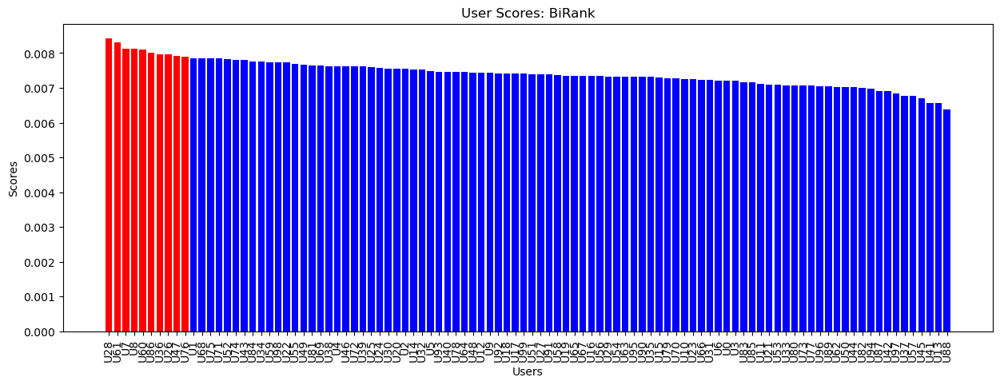

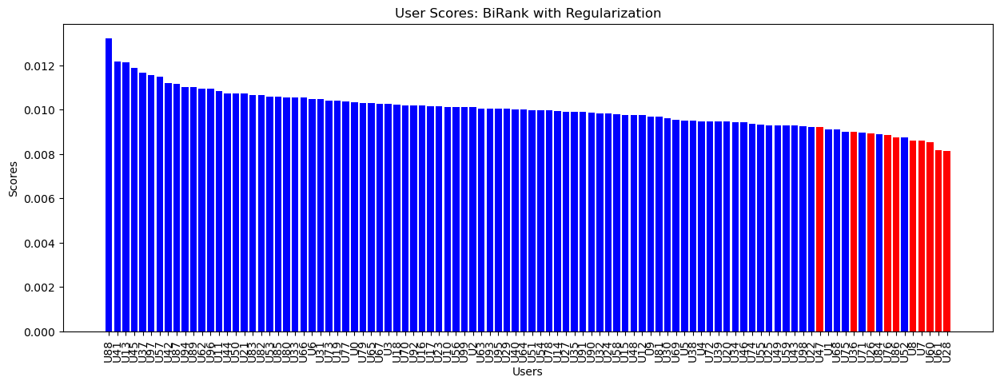

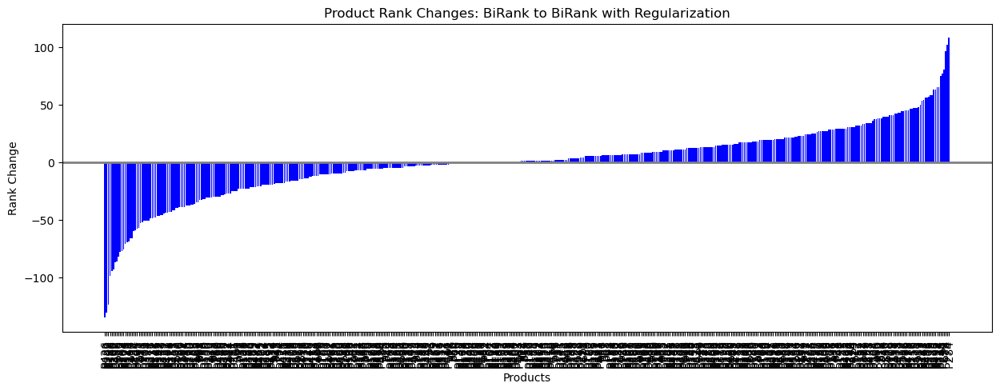

In [309]:
# Identify top 10 high-activity users based on degree
high_activity_users = sorted(relative_user_activity, key=relative_user_activity.get, reverse=True)[:10]

# Check high-activity users
print("High activity users:", high_activity_users)

import matplotlib.pyplot as plt

# Function to plot user scores
def plot_user_scores(user_scores, high_activity_users, title):
    # Rank users based on their scores
    user_ranking = np.argsort(-user_scores)
    
    # Highlight high-activity users
    colors = ['red' if users[i] in high_activity_users else 'blue' for i in user_ranking]
    
    plt.figure(figsize=(15, 5))
    plt.bar(range(len(user_scores)), user_scores[user_ranking], color=colors)
    plt.xlabel('Users')
    plt.ylabel('Scores')
    plt.title(title)
    plt.xticks(range(len(user_scores)), [users[i] for i in user_ranking], rotation=90)
    plt.show()

# Plot user scores for BiRank
plot_user_scores(user_scores, high_activity_users, 'User Scores: BiRank')

# Plot user scores for BiRank with Regularization
plot_user_scores(user_scores_reg, high_activity_users, 'User Scores: BiRank with Regularization')

# Function to plot changes in product rankings with positive changes on the left and negative on the right
def plot_product_rank_changes_ordered(product_scores, product_scores_reg, title):
    # Rank products based on their scores from BiRank
    product_ranking = np.argsort(-product_scores)
    product_ranking_reg = np.argsort(-product_scores_reg)
    
    # Calculate rank changes for each product
    rank_changes = []
    for idx in range(len(product_scores)):
        new_rank = np.where(product_ranking_reg == idx)[0][0]
        old_rank = np.where(product_ranking == idx)[0][0]
        rank_changes.append(new_rank - old_rank)

    # Sort products by rank change values
    products_sorted_by_change = sorted(zip(products, rank_changes), key=lambda x: x[1])
    sorted_products, sorted_changes = zip(*products_sorted_by_change)

    # Plotting
    plt.figure(figsize=(15, 5))
    plt.bar(range(len(sorted_changes)), sorted_changes, color='blue')
    plt.xlabel('Products')
    plt.ylabel('Rank Change')
    plt.title(title)
    plt.xticks(range(len(sorted_changes)), sorted_products, rotation=90)
    plt.axhline(0, color='grey', lw=2)  # Line for no change
    plt.show()

# Plot the changes in product ranks
plot_product_rank_changes_ordered(product_scores, product_scores_reg, 'Product Rank Changes: BiRank to BiRank with Regularization')

### Power Law

In [174]:
def generate_power_law_bipartite_graph(num_users, num_products, exponent=2.5, extra_edges=5):
    while True:
        user_degrees = np.random.zipf(a=exponent, size=num_users)
        product_degrees = np.random.zipf(a=exponent, size=num_products)

        # # Randomly select 10 users and increase their degrees
        # biased_users = random.sample(range(num_users), 10)
        # for i in biased_users:
        #     user_degrees[i] += extra_edges

        # Adjust product degrees if necessary
        if sum(user_degrees) != sum(product_degrees):
            difference = sum(user_degrees) - sum(product_degrees)
            random_indices = np.random.choice(num_products, abs(difference), replace=True)
            if difference > 0:
                for i in random_indices:
                    product_degrees[i] += 1
            else:
                for i in random_indices:
                    product_degrees[i] = max(1, product_degrees[i] - 1)

        if sum(user_degrees) == sum(product_degrees):
            break

    B = nx.bipartite.configuration_model(user_degrees, product_degrees)
    B = nx.Graph(B)  # Convert to a simple graph
    B.remove_edges_from(nx.selfloop_edges(B))

    # Relabel nodes to match the string format
    label_mapping = {i: f'U{i}' for i in range(num_users)}
    label_mapping.update({i + num_users: f'P{i}' for i in range(num_products)})
    B = nx.relabel_nodes(B, label_mapping)

    users = [f'U{i}' for i in range(num_users)]
    products = [f'P{i}' for i in range(num_products)]

    return B, users, products

# Example usage
B_power_law, users_power_law, products_power_law = generate_power_law_bipartite_graph(100, 50, exponent=1.8)

In [185]:
def generate_power_law_bipartite_graph(num_users, num_products, user_exponent=2.5, product_degree_min=1, product_degree_max=10):
    # Generate user degrees following a power-law distribution
    user_degrees = np.random.zipf(a=user_exponent, size=num_users)

    # Generate product degrees randomly within specified range
    product_degrees = np.random.randint(product_degree_min, product_degree_max + 1, num_products)

    # Adjust product degrees if necessary to match the sum of user degrees
    while sum(user_degrees) != sum(product_degrees):
        difference = sum(user_degrees) - sum(product_degrees)
        random_indices = np.random.choice(num_products, abs(difference), replace=True)
        if difference > 0:
            for i in random_indices:
                product_degrees[i] += 1
        else:
            for i in random_indices:
                product_degrees[i] = max(product_degree_min, product_degrees[i] - 1)

    # Create the bipartite graph
    B = nx.bipartite.configuration_model(user_degrees, product_degrees)
    B = nx.Graph(B)  # Convert to a simple graph
    B.remove_edges_from(nx.selfloop_edges(B))

    # Relabel nodes to match the string format
    label_mapping = {i: f'U{i}' for i in range(num_users)}
    label_mapping.update({i + num_users: f'P{i}' for i in range(num_products)})
    B = nx.relabel_nodes(B, label_mapping)

    users = [f'U{i}' for i in range(num_users)]
    products = [f'P{i}' for i in range(num_products)]

    return B, users, products

# Example usage
B_power_law, users_power_law, products_power_law = generate_power_law_bipartite_graph(100, 50, user_exponent=1.8)

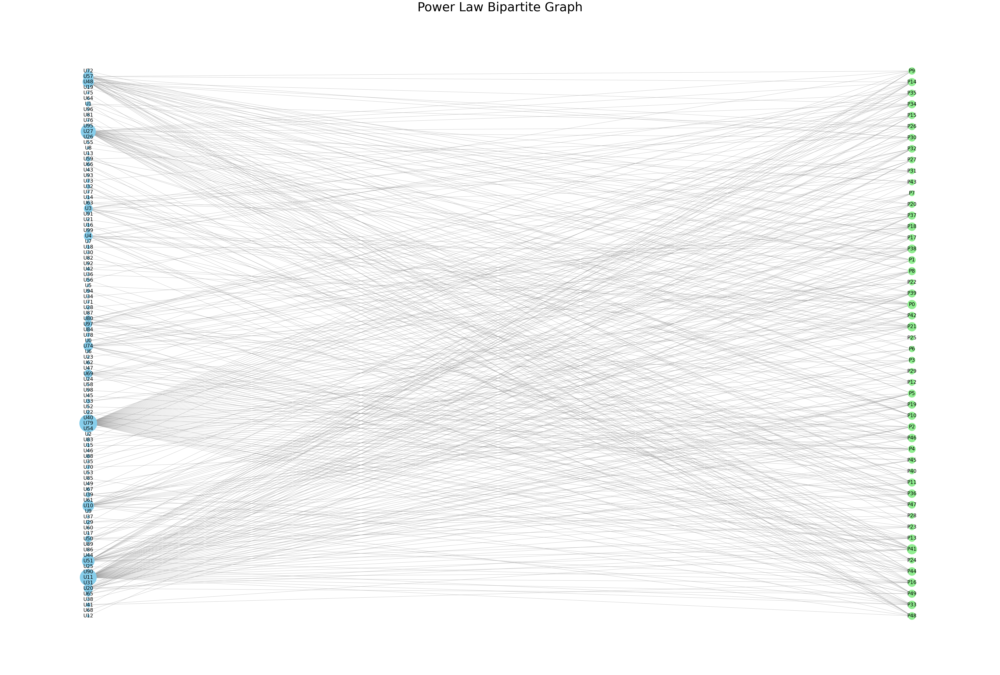

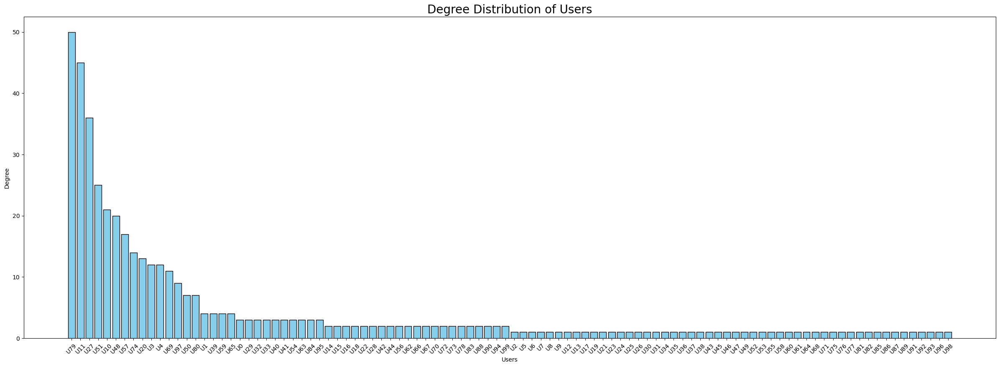

In [186]:
# Plot the random graph
plot_bipartite_graph(B_power_law, title="Power Law Bipartite Graph")

# Example usage with the B_random graph and users list
plot_user_degree_distribution(B_power_law, users_power_law)

In [187]:
# Create an empty adjacency matrix
adj_matrix = spa.dok_matrix((len(users_power_law), len(products_power_law)), dtype=np.int8)

# Populate the adjacency matrix based on the edges in B_power_law
for u, p in B_power_law.edges():
    if u in users_power_law and p in products_power_law:
        u_idx = users_power_law.index(u)
        p_idx = products_power_law.index(p)
        adj_matrix[u_idx, p_idx] = 1  # Assuming all reviews are weighted equally

# Convert to a CSR (Compressed Sparse Row) matrix
adj_matrix_csr = adj_matrix.tocsr()

In [188]:
# Run the BiRank algorithm
# You may need to adjust the parameters like alpha, beta, max_iter based on your specific needs
user_scores, product_scores = birankpy.birank(adj_matrix_csr, normalizer='BiRank',alpha=0.85, beta=0.85, max_iter=1000, tol=1e-4)

# user_scores and product_scores are numpy arrays containing the ranking scores of users and products, respectively
user_ranking = np.argsort(-user_scores)  # - for descending order
product_ranking = np.argsort(-product_scores)

# Print top ranked users and products
print("Top ranked users:", [users_power_law[i] for i in user_ranking[:10]])  # adjust the slice as needed
print("Top ranked products:", [products_power_law[i] for i in product_ranking[:10]])

Top ranked users: ['U79', 'U11', 'U27', 'U51', 'U10', 'U48', 'U57', 'U74', 'U20', 'U3']
Top ranked products: ['P41', 'P33', 'P0', 'P21', 'P38', 'P18', 'P36', 'P49', 'P46', 'P44']


In [189]:
# Run the BiRank algorithm with bias correction
# You may need to adjust the parameters like alpha, beta, max_iter based on your specific needs

# Run the BiRank algorithm with bias correction
user_scores_reg, product_scores_reg = birank_with_regularization(
    adj_matrix_csr,
    normalizer='BiRank',
    gamma =0.000000000000000000000000001,
    alpha=0.85,
    beta=0.85,
    max_iter=1000,
    tol=1e-4
)

# user_scores and product_scores are numpy arrays containing the ranking scores of users and products, respectively
user_ranking_reg = np.argsort(-user_scores_reg)  # - for descending order
product_ranking_reg = np.argsort(-product_scores_reg)

# Print top ranked users and products
print("Top ranked users:", [users_power_law[i] for i in user_ranking_reg[:10]])  # adjust the slice as needed
print("Top ranked products:", [products_power_law[i] for i in product_ranking_reg[:10]])

Top ranked users: ['U21', 'U60', 'U35', 'U64', 'U68', 'U19', 'U71', 'U49', 'U2', 'U58']
Top ranked products: ['P0', 'P27', 'P28', 'P29', 'P30', 'P31', 'P32', 'P33', 'P34', 'P35']


In [190]:
# Disparity
# Calculate the degree of each user node
# Calculate the total degree of the network (sum of degrees of all user nodes)
total_degree = sum(B_power_law.degree(node) for node in users)

# Compute relative user activity for each user
relative_user_activity = {node: B_power_law.degree(node) / total_degree for node in users}

# Convert relative_user_activity dictionary values to a numpy array
relative_user_activity_array = np.array([relative_user_activity[node] for node in users])

high_activity_avg_rank, low_activity_avg_rank = calculate_disparity(user_scores, relative_user_activity_array, 0.1)
gini_coefficient_birank = calculate_gini_coefficient(product_scores)

metric_score_birank = fairness_metric(high_activity_avg_rank, low_activity_avg_rank, gini_coefficient_birank)

In [191]:
print("High activity average rank of Birank:", high_activity_avg_rank)
print("Low activity average rank of Birank:", low_activity_avg_rank)
print("Gini Coefficient of Birank:", gini_coefficient_birank)
print("Fairness metric of Birank:", metric_score_birank)

High activity average rank of Birank: 0.009847051070435311
Low activity average rank of Birank: 0.008850711227507321
Gini Coefficient of Birank: 0.06494357497633628
Fairness metric of Birank: 0.08233562939968082


In [192]:
high_activity_avg_rank_reg, low_activity_avg_rank_reg = calculate_disparity(user_scores_reg, relative_user_activity_array, 0.1)
gini_coefficient_reg = calculate_gini_coefficient(product_scores_reg)

metric_score_reg = fairness_metric(high_activity_avg_rank_reg, low_activity_avg_rank_reg, gini_coefficient_reg)

In [193]:
print("High activity average rank of Birank with reg:", high_activity_avg_rank_reg)
print("Low activity average rank of Birank with reg:", low_activity_avg_rank_reg)
print("Gini Coefficient of Birank with reg:", gini_coefficient_reg)
print("Fairness metric of Birank with reg:", metric_score_reg)

High activity average rank of Birank with reg: 0.010400304485810821
Low activity average rank of Birank with reg: 0.010132687186715922
Gini Coefficient of Birank with reg: 1.1102230246251566e-17
Fairness metric of Birank with reg: 1.999923989073551e-06


In [194]:
rank_corr_user = rank_correlation(user_scores, user_scores_reg)
print("Rank Correlation of users between birank and birank with reg:", rank_corr_user)

rank_corr_prod = rank_correlation(product_scores, product_scores_reg)
print("Rank Correlation of products between birank and birank with reg:", rank_corr_prod)

Rank Correlation of users between birank and birank with reg: -0.7781381107308344
Rank Correlation of products between birank and birank with reg: nan


High activity users: ['U10', 'U3', 'U4', 'U1', 'U2', 'U5', 'U6', 'U7', 'U8', 'U9']


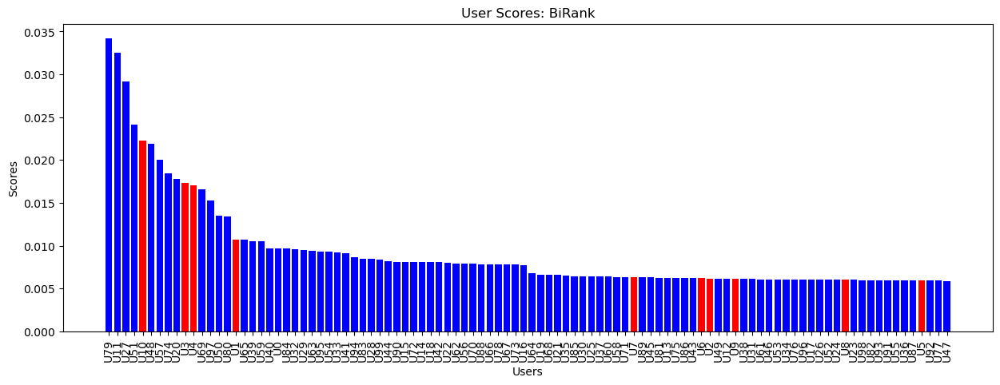

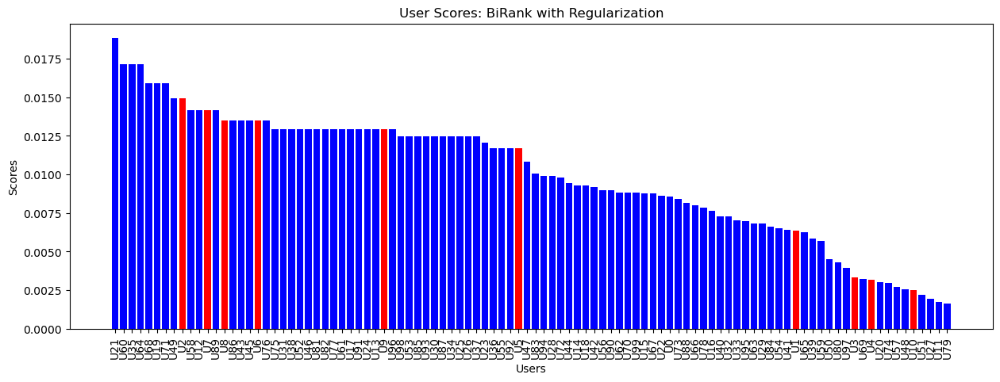

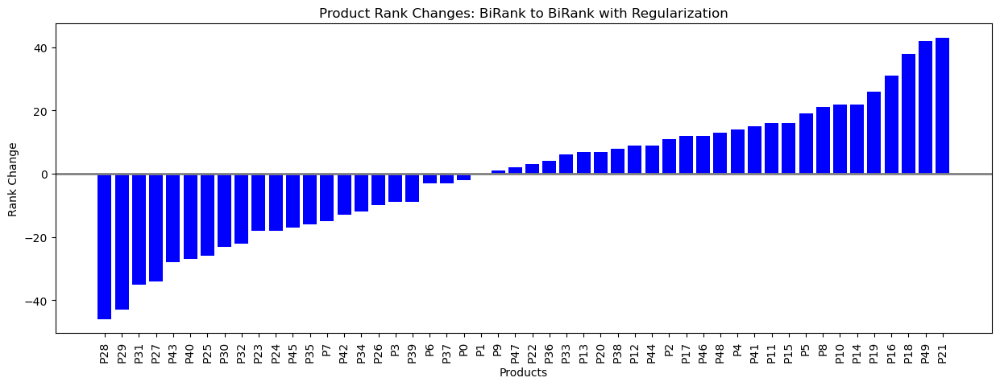

In [195]:
# Identify top 10 high-activity users based on degree
high_activity_users = sorted(relative_user_activity, key=relative_user_activity.get, reverse=True)[:10]

# Check high-activity users
print("High activity users:", high_activity_users)

import matplotlib.pyplot as plt

# Function to plot user scores
def plot_user_scores(user_scores, high_activity_users, title):
    # Rank users based on their scores
    user_ranking = np.argsort(-user_scores)
    
    # Highlight high-activity users
    colors = ['red' if users_power_law[i] in high_activity_users else 'blue' for i in user_ranking]
    
    plt.figure(figsize=(15, 5))
    plt.bar(range(len(user_scores)), user_scores[user_ranking], color=colors)
    plt.xlabel('Users')
    plt.ylabel('Scores')
    plt.title(title)
    plt.xticks(range(len(user_scores)), [users_power_law[i] for i in user_ranking], rotation=90)
    plt.show()

# Plot user scores for BiRank
plot_user_scores(user_scores, high_activity_users, 'User Scores: BiRank')

# Plot user scores for BiRank with Regularization
plot_user_scores(user_scores_reg, high_activity_users, 'User Scores: BiRank with Regularization')

# Function to plot changes in product rankings with positive changes on the left and negative on the right
def plot_product_rank_changes_ordered(product_scores, product_scores_reg, title):
    # Rank products based on their scores from BiRank
    product_ranking = np.argsort(-product_scores)
    product_ranking_reg = np.argsort(-product_scores_reg)
    
    # Calculate rank changes for each product
    rank_changes = []
    for idx in range(len(product_scores)):
        new_rank = np.where(product_ranking_reg == idx)[0][0]
        old_rank = np.where(product_ranking == idx)[0][0]
        rank_changes.append(new_rank - old_rank)

    # Sort products by rank change values
    products_sorted_by_change = sorted(zip(products_power_law, rank_changes), key=lambda x: x[1])
    sorted_products, sorted_changes = zip(*products_sorted_by_change)

    # Plotting
    plt.figure(figsize=(15, 5))
    plt.bar(range(len(sorted_changes)), sorted_changes, color='blue')
    plt.xlabel('Products')
    plt.ylabel('Rank Change')
    plt.title(title)
    plt.xticks(range(len(sorted_changes)), sorted_products, rotation=90)
    plt.axhline(0, color='grey', lw=2)  # Line for no change
    plt.show()

# Plot the changes in product ranks
plot_product_rank_changes_ordered(product_scores, product_scores_reg, 'Product Rank Changes: BiRank to BiRank with Regularization')